# Vaccine visualization

- average sentiment by vaccine (hashtags)
- amount of positive, negative and neutral sentiment
- Vaccine sentiment over time
    - Vaccine sentiment over time with selectable Vaccine
- Mapplot: what region talks about what vaccine
- Mapplot: what region has what sentiment

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import statistics
import scipy
from scipy import signal

In [2]:
vaccine_tweets = pd.read_csv("../data/processed/vaccine_tweets_with_sentiment.csv", index_col=0, converters={'hashtags': eval, 'sentiment':eval})
vaccination_progress = pd.read_csv("../data/raw/country_vaccinations.csv")
vaccination_progress_by_manufacturer = pd.read_csv("../data/raw/country_vaccinations_by_manufacturer.csv")

In [3]:
vaccine_tweets

,id,created_at,user,geo,full_text,hashtags,user_id,PfizerBiontech,SputnikV,Sinopharm,Sinovac,Moderna,AstraZeneca,Covaxin,JandJ,user_location,coordinates,corpus,sentiment,sentiment_compound
0,1382113874439192576,2021-04-13 23:30:00+00:00,"{'id': 758414676480946200, 'id_str': '75841467...",NaN,"""Safe and Effective, Safe and Effective, Safe ...","[mrna, covidvaccine, johnsonandjohnson, pfizer...",758414676480946200,1,0,0,1,1,1,0,1,NaN,NaN,safe effective safe effective safe effective s...,"{'neg': 0.0, 'neu': 0.104, 'pos': 0.896, 'comp...",0.9953
1,1362299993504145408,2021-02-18 07:16:43+00:00,"{'id': 160763636, 'id_str': '160763636', 'name...",NaN,Hey dear friends my #COVAXIN is done and feel ...,"[covaxin, covid19, vaccinemaitri]",160763636,0,0,0,0,0,0,1,0,India,"[22.3511148, 78.6677428]",hey dear friend covaxin done feel good thanks ...,"{'neg': 0.0, 'neu': 0.311, 'pos': 0.689, 'comp...",0.9876
2,1375483502616010752,2021-03-26 16:23:16+00:00,"{'id': 1356008062620991500, 'id_str': '1356008...",NaN,We will be giving thousands of doses of the in...,"[oxfordastrazeneca, passover, covidjab]",1356008062620991500,0,0,0,0,0,1,0,0,NaN,NaN,giving thousand dos incredibly safe powerfully...,"{'neg': 0.0, 'neu': 0.298, 'pos': 0.702, 'comp...",0.9842
3,1362778395302653952,2021-02-19 14:57:43+00:00,"{'id': 1263498191502282800, 'id_str': '1263498...",NaN,Congratulations on BioAsia Genome Valley Excel...,"[covaxin, vaccine]",1263498191502282800,0,0,0,0,0,0,1,0,NaN,NaN,congratulation bioasia genome valley excellenc...,"{'neg': 0.0, 'neu': 0.272, 'pos': 0.728, 'comp...",0.9842
4,1367114490890752000,2021-03-03 14:07:49+00:00,"{'id': 143025857, 'id_str': '143025857', 'name...",NaN,Better efficacy than Oxford/covishield's 62%. ...,[covaxin],143025857,0,0,0,0,0,0,1,0,NaN,NaN,better efficacy oxford covishield best inactiv...,"{'neg': 0.0, 'neu': 0.339, 'pos': 0.661, 'comp...",0.9837
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101018,1402675902220222464,2021-06-09 17:16:10+00:00,"{'id': 1118813148914569200, 'id_str': '1118813...",NaN,@ThrowAw31644033 @Daveyji @socioEqualiser @sap...,"[mhra, astrazeneca, pfizer, moderna, unspecified]",1118813148914569200,1,0,0,0,1,1,0,0,NaN,NaN,death reported mhra uk astrazeneca reaction de...,"{'neg': 0.609, 'neu': 0.391, 'pos': 0.0, 'comp...",-0.9761
101019,1403052639961681920,2021-06-10 18:13:11+00:00,"{'id': 760564088854442000, 'id_str': '76056408...",NaN,"1,295 deaths after ð reported to #MHRA in U...","[mhra, astrazeneca, pfizer, moderna, unspecified]",760564088854442000,1,0,0,0,1,1,0,0,NaN,NaN,death reported mhra uk astrazeneca reaction de...,"{'neg': 0.609, 'neu': 0.391, 'pos': 0.0, 'comp...",-0.9761
101020,1395373649113268224,2021-05-20 13:39:37+00:00,"{'id': 1030608306, 'id_str': '1030608306', 'na...",NaN,@MrLichtenstein @Doomsday_Clock 180 UK deaths ...,"[mhra, astrazeneca, pfizer, moderna, unspecified]",1030608306,1,0,0,0,1,1,0,0,NaN,NaN,clock uk death reported mhra following syringe...,"{'neg': 0.565, 'neu': 0.435, 'pos': 0.0, 'comp...",-0.9761
101021,1379804303947358208,2021-04-07 14:32:36+00:00,"{'id': 978836543652712400, 'id_str': '97883654...",NaN,"Always said ""they rushed the vaccine"" but no, ...",[oxfordastrazeneca],978836543652712400,0,0,0,0,0,1,0,0,NaN,NaN,always said rushed vaccine trusted scientist l...,"{'neg': 0.55, 'neu': 0.387, 'pos': 0.063, 'com...",-0.9774


In [4]:
vaccination_progress_by_manufacturer = vaccination_progress_by_manufacturer.groupby(["vaccine","date"])["total_vaccinations"].sum().reset_index()

---

# Amount of vaccine mentions

In [5]:
fig = px.pie(vaccine_tweets,
             values=[
                 vaccine_tweets.PfizerBiontech.sum(),
                 vaccine_tweets.SputnikV.sum(),
                 vaccine_tweets.Sinopharm.sum(),
                 vaccine_tweets.Sinovac.sum(),
                 vaccine_tweets.Moderna.sum(),
                 vaccine_tweets.AstraZeneca.sum(),
                 vaccine_tweets.Covaxin.sum(),
                 vaccine_tweets.JandJ.sum()
                    ],
             names=[
                 "PfizerBiontech",
                 "SputnikV",
                 "Sinopharm",
                 "Sinovac",
                 "Moderna",
                 "AstraZeneca",
                 "Covaxin",
                 "JandJ"
                   ],
             title='Total Vaccine Mentions')
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.write_html("../reports/figures/VaccineSentiment/Vaccine_Mentions.html")

fig.show()

___

# Most talked about vaccine over time

In [6]:
vaccine_tweets_temp = vaccine_tweets.copy()
vaccine_tweets_temp["created_at"] = pd.to_datetime(vaccine_tweets["created_at"]).dt.strftime('%Y-%m-%d')
vaccine_tweets_temp["count"] = 1

In [7]:
 vaccine_tweets_temp = vaccine_tweets_temp[["created_at", "PfizerBiontech", "SputnikV", "Sinopharm", "Sinovac", "Moderna", "AstraZeneca", "Covaxin", "JandJ","count"]]

In [8]:
vaccine_tweets_temp_count = vaccine_tweets_temp.groupby(["created_at"])["PfizerBiontech", "SputnikV", "Sinopharm", "Sinovac", "Moderna", "AstraZeneca", "Covaxin", "JandJ"].sum()

<ipython-input-8-7a292a2c6dc0>:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [9]:
vaccine_tweets_temp_count = vaccine_tweets_temp_count.reset_index(drop = False)

In [10]:
vax_tweets = pd.DataFrame(columns=["created_at","Vaccine","TweetAmount"])

for i in range(len(vaccine_tweets_temp_count)):
    for column in (vaccine_tweets_temp_count.columns):
        if column != "created_at":
            vax_tweets.loc[len(vax_tweets)+1] = [vaccine_tweets_temp_count["created_at"][i], column, vaccine_tweets_temp_count[column][i]]

In [11]:
fig = px.bar(vax_tweets, x="Vaccine", y="TweetAmount",\
             animation_frame=vax_tweets.created_at, range_y=[0,500],\
             title="Tweet Volume by day")
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 20
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Tweet_Volume_Day.html")

Note: this is the absolute tweet amount per day, should i do a relative tweet amount? E.g. out of all tweets sent that day, how many were ...

___

## Total tweet amount over time

In [12]:
vax_tweets_2 = vaccine_tweets_temp_count.copy()

for column in vax_tweets_2:
    if column != "created_at":
        for i in range(len(vax_tweets_2[column])-1):
            vax_tweets_2[column][i+1] = vax_tweets_2[column][i]+vax_tweets_2[column][i+1]

<ipython-input-12-eaf875607334>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [13]:
vax_tweets_3 = pd.DataFrame(columns=["created_at","Vaccine","TweetAmount"])

for i in range(len(vax_tweets_2)):
    for column in (vax_tweets_2.columns):
        if column != "created_at":
            vax_tweets_3.loc[len(vax_tweets_3)+1] = [vax_tweets_2["created_at"][i], column, vax_tweets_2[column][i]]

In [14]:
fig = px.bar(vax_tweets_3, x="Vaccine", y="TweetAmount",\
             title="Tweet Amount Over Time",\
             animation_frame=vax_tweets.created_at, range_y=[0,35000])
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 20
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Tweet_Volume_All.html")

___

# Average positive, negative and neutral sentiment

In [15]:
pos_sentiment = [sentiment for sentiment in vaccine_tweets["sentiment_compound"] if (sentiment >= 0.33)]
neg_sentiment = [sentiment for sentiment in vaccine_tweets["sentiment_compound"] if (sentiment <= - 0.33)]
neu_sentiment = [sentiment for sentiment in vaccine_tweets["sentiment_compound"] if (sentiment < 0.33 and sentiment > -0.33)]

In [16]:
fig = px.box(
    y=vaccine_tweets["sentiment_compound"],
    title = "Overall Sentiment",
    labels={"y":"Sentiment"})
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Sentiment_Boxplot.html")

In [17]:
fig = px.bar(
    x=["Positive", "Neutral", "Negative"],
    y=[len(pos_sentiment), len(neu_sentiment), len(neg_sentiment)],
    title="Amount of tweets by sentiment",
    labels={"x":"Sentiment","y":"Amount of tweets"})
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Sentiment_Amount.html")

___

# Average Sentiment by Vaccine

In [18]:
pfizerBiontech_tweets = vaccine_tweets[vaccine_tweets["PfizerBiontech"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
sputnikV_tweets = vaccine_tweets[vaccine_tweets["SputnikV"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
sinopharm_tweets = vaccine_tweets[vaccine_tweets["Sinopharm"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
sinovac_tweets = vaccine_tweets[vaccine_tweets["Sinovac"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
moderna_tweets = vaccine_tweets[vaccine_tweets["Moderna"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
astraZeneca_tweets = vaccine_tweets[vaccine_tweets["AstraZeneca"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
covaxin_tweets = vaccine_tweets[vaccine_tweets["Covaxin"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
jandj_tweets = vaccine_tweets[vaccine_tweets["JandJ"] == 1][["created_at","sentiment_compound"]].set_index("created_at")

In [19]:
pfizerBiontech_avg_sentiment = statistics.mean(pfizerBiontech_tweets["sentiment_compound"])
sputnikV_avg_sentiment = statistics.mean(sputnikV_tweets["sentiment_compound"])
sinopharm_avg_sentiment = statistics.mean(sinopharm_tweets["sentiment_compound"])
sinovac_avg_sentiment = statistics.mean(sinovac_tweets["sentiment_compound"])
moderna_avg_sentiment = statistics.mean(moderna_tweets["sentiment_compound"])
astraZeneca_avg_sentiment = statistics.mean(astraZeneca_tweets["sentiment_compound"])
covaxin_avg_sentiment = statistics.mean(covaxin_tweets["sentiment_compound"])
jandj_avg_sentiment = statistics.mean(jandj_tweets["sentiment_compound"])

In [20]:
fig = px.bar(
    x=["PfizerBiontech", "SputnikV", "Sinopharm", "Sinovac", "Moderna", "AstraZeneca", "Covaxin", "JandJ"],
    y=[pfizerBiontech_avg_sentiment, sputnikV_avg_sentiment, sinopharm_avg_sentiment, sinovac_avg_sentiment, moderna_avg_sentiment, astraZeneca_avg_sentiment, covaxin_avg_sentiment, jandj_avg_sentiment],
    title="Mean sentiment by Vaccine",
    labels={"x":"Vaccine","y":"Mean sentiment"})
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Mean_Vaccine_Sentiment.html")

In [21]:
fig = px.box(
    y=pfizerBiontech_tweets["sentiment_compound"],
    points="suspectedoutliers",
    title = "Overall Sentiment for PfizerBiontech",
    labels={"y":"Sentiment"})
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Overall_Sentiment_PfizerBiontech.html")

___

# Vaccine sentiment over time (by vaccines)

In [22]:
pfizerBiontech_tweets.head()

,sentiment_compound
created_at,
2021-04-13 23:30:00+00:00,0.9953
2021-02-24 11:39:21+00:00,0.9834
2021-03-09 14:46:06+00:00,0.9792
2021-05-26 20:13:11+00:00,0.9758
2021-02-17 17:42:58+00:00,0.9735


In [23]:
merged_vaccine_tweets = pd.merge(pfizerBiontech_tweets, sputnikV_tweets, left_index=True, right_index=True, how='outer')\
.merge(sinopharm_tweets, left_index=True, right_index=True, how="outer")\
.merge(sinovac_tweets, left_index=True, right_index=True, how="outer")\
.merge(moderna_tweets, left_index=True, right_index=True, how="outer")\
.merge(astraZeneca_tweets, left_index=True, right_index=True, how="outer")\
.merge(covaxin_tweets, left_index=True, right_index=True, how="outer")\
.merge(jandj_tweets, left_index=True, right_index=True, how="outer")




In [24]:
merged_vaccine_tweets.columns = ["PfizerBiontech","SputnikV","Sinopharm","Sinovac","Moderna","AstraZeneca","Covaxin","JandJ"]

In [25]:
def sentiment_over_time_alt(dataset):
    fig = px.line(
        dataset.sort_values("created_at"),
        x=dataset.sort_values("created_at").index,
        y=signal.savgol_filter(
        dataset.sort_values("created_at")["sentiment_compound"],
        51,
        2
        ))
    
    fig.show()

In [26]:
vaccination_progress_by_manufacturer[vaccination_progress_by_manufacturer["vaccine"] == "Johnson&Johnson"]

,vaccine,date,total_vaccinations
26,Johnson&Johnson,2020-12-27,0
27,Johnson&Johnson,2020-12-28,0
28,Johnson&Johnson,2020-12-29,0
29,Johnson&Johnson,2020-12-30,0
30,Johnson&Johnson,2020-12-31,0
...,...,...,...
203,Johnson&Johnson,2021-06-22,16022017
204,Johnson&Johnson,2021-06-23,16118153
205,Johnson&Johnson,2021-06-24,16226816
206,Johnson&Johnson,2021-06-25,19033709


In [27]:
total_vaccine_process = vaccination_progress.groupby(["date"])["total_vaccinations"].sum().reset_index()

In [28]:
vaccination_progress_by_manufacturer["vaccine"].unique()[1:]

array(['Johnson&Johnson', 'Moderna', 'Oxford/AstraZeneca',
       'Pfizer/BioNTech', 'Sinopharm/Beijing', 'Sinovac', 'Sputnik V'],
      dtype=object)

In [29]:
def sentiment_over_time(dataset):

    fig = go.Figure()
    
    for vaccine in vaccination_progress_by_manufacturer["vaccine"].unique()[1:]:
        fig.add_trace(
            go.Line(
            x = vaccination_progress_by_manufacturer[vaccination_progress_by_manufacturer["vaccine"]==vaccine]["date"],
            y = vaccination_progress_by_manufacturer[vaccination_progress_by_manufacturer["vaccine"]==vaccine]["total_vaccinations"],
            yaxis='y1',
            name= vaccine + " doses"
            )
        )
    
    for column in dataset.columns.to_list():
        fig.add_trace(
            go.Line(
                x = dataset.sort_values("created_at")[column].dropna().index,
                y = signal.savgol_filter(
                    dataset.sort_values("created_at")[column].dropna(),
                    201,
                    4
                    ),
                yaxis = "y2",
                name = column + " senti."
            )
        )
        
    
    # Add dropdown
    fig.update_layout(
        updatemenus=[
            dict(
                buttons=list([
                    dict( 
                        args=[{'visible': [True,True,True,True,True,True,True,True,True,True,True,True,True,True,True]}, 
                               {'title' : '(Smoothed) Sentiment over time'}],
                        label="All",
                        method="update"
                    ),
                    dict( 
                        args=[{'visible': [False,False,False,True,False,False,False,True,False,False,False,False,False,False,False]},
                             {'title' : '(Smoothed) Sentiment over time for PfizerBiontech'}],
                        label="PfizerBiontech",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [False,False,False,False,False,False,True,False,True,False,False,False,False,False,False]},
                             {'title' : '(Smoothed) Sentiment over time for SputnikV'}],
                        label="SputnikV",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [False,False,False,False,True,False,False,False,False,True,False,False,False,False,False]},
                             {'title' : '(Smoothed) Sentiment over time for Sinopharm'}],
                        label="Sinopharm",
                        method="update",
                    ),
                    dict(
                        args=[{'visible': [False,False,False,False,False,True,False,False,False,False,True,False,False,False,False]},
                             {'title' : '(Smoothed) Sentiment over time for Sinovac'}],
                        label="Sinovac",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [False,True,False,False,False,False,False,False,False,False,False,True,False,False,False]}, 
                             {'title' : '(Smoothed) Sentiment over time for Moderna'}],
                        label="Moderna",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [False,False,True,False,False,False,False,False,False,False,False,False,True,False,False]}, 
                             {'title' : '(Smoothed) Sentiment over time for AstraZeneca'}],
                        label="AstraZeneca",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [False,False,False,False,False,False,False,False,False,False,False,False,False,True,False]},
                             {'title' : '(Smoothed) Sentiment over time for Covaxin'}],
                        label="Covaxin",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [True,False,False,False,False,False,False,False,False,False,False,False,False,False,True]},
                             {'title' : '(Smoothed) Sentiment over time for JandJ'}],
                        label="JandJ",
                        method="update"
                    )                    
                ]),
                direction="down",
                pad={"r": 10, "t": 10},
                showactive=True,
                x=1.0,
                xanchor="right",
                y=1.2,
                yanchor="top"
            ),
        ],
        xaxis_title="Time",
        legend_title="Vaccines"
    )
    
    fig.update(layout=go.Layout(yaxis1 = go.YAxis(title='Vaccination Progress', titlefont=go.Font(color='SteelBlue'), side="right"),
                                yaxis2 = go.YAxis(title='Sentiment', titlefont=go.Font(color='Red'), overlaying='y', side="left")))
    
    fig.show()
    fig.write_html("../reports/figures/VaccineSentiment/Vaccine_Sentiment_Over_Time.html")

In [30]:
sentiment_over_time(merged_vaccine_tweets)

/opt/anaconda3/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.


/opt/anaconda3/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:322: DeprecationWarning:

plotly.graph_objs.Font is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.Font
  - plotly.graph_objs.layout.hoverlabel.Font
  - etc.


/opt/anaconda3/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:572: DeprecationWarning:

plotly.graph_objs.YAxis is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.YAxis
  - plotly.graph_objs.layout.scene.YAxis




## Google Trends analysis (w/ pytrends):

In [31]:
from pytrends.request import TrendReq

In [32]:
#pytrend = TrendReq()

In [33]:
def getRisingTrends(query, time, qtype="rising"):
    pytrend = TrendReq()
    pytrend.build_payload(kw_list=[query], timeframe=time)
    print(pytrend.related_queries()[query][qtype])

### PfizerBiontech Search Queries:
- lowest: 16.01.

In [34]:
getRisingTrends("Pfizer", "2021-01-20 2021-01-22", qtype="rising")

                                     query  value
0          10 dead in germany after pfizer   5800
1                    israel pfizer vaccine    350
2                           biontech aktie    170
3                  pfizer vaccine efficacy    160
4                            pfizer azioni    150
5   pfizer vaccine side effects first dose    100
6             pfizer vaccine effectiveness     80
7                       pfizer stock price     80
8               pfizer vaccine second dose     70
9                             pfizer aktie     70
10               pfizer vs moderna vaccine     70
11                      szczepionka pfizer     60
12                            pfizer stock     60
13                               dow jones     60
14            where is pfizer vaccine made     40


In [35]:
getRisingTrends("BioNTech", "2021-01-15 2021-01-17")

                          query   value
0             norwegen biontech  301900
1  norwegen impfverbot biontech  201300


In [36]:
getRisingTrends("Pfizer", '2021-05-23 2021-05-25')

                                      query  value
0        where can i get the pfizer vaccine  25250
1                        myocarditis pfizer   1050
2             pfizer vaccine heart problems    600
3                        pfizer vaccine nsw    350
4              vaccino pfizer come funziona    350
5   efectos secundarios de la vacuna pfizer    300
6                 pfizer heart inflammation    250
7            effet secondaire vaccin pfizer    200
8                   effet secondaire pfizer    170
9                             pfizer rokote     80
10                 pfizer vaccine australia     70
11                       szczepionka pfizer     70
12                  pfizer vaccine malaysia     60
13              johnson and johnson vaccine     50
14       is the pfizer vaccine fda approved     50
15                      pfizer vaccine news     50


### Sinopharm/Sinovac Search Queries:
- highest: jun2

In [37]:
getRisingTrends("Sinovac", '2021-06-01 2021-06-03')

                     query  value
0         pfizer o sinovac  59500
1     sinovac who approval    350
2        sinovac singapore    350
3              sinovac oms    250
4   biontech mi sinovac mi    250
5           biontech aşısı    120
6            vacuna pfizer    100
7        sinovac impfstoff    100
8            sinovac aşısı    100
9              astrazeneca     90
10         sinovac vaccine     70
11    sinovac side effects     70
12             sinovac who     60
13     sinovac efectividad     50


### AstraZeneca Search Queries:
- Mar15

In [38]:
getRisingTrends("AstraZeneca", "2021-03-14 2021-03-16")

                                       query  value
0                    astrazeneca vaccine usa  26400
1             hirnvenenthrombose astrazeneca  19500
2                            pei astrazeneca  17500
3                         biella astrazeneca  15900
4            sinusvenenthrombose astrazeneca  14700
5           astrazeneca deutschland gestoppt  12600
6                        sinusvenenthrombose  12350
7                españa suspende astrazeneca   8750
8              astrazeneca vaccine australia   7100
9                       alemania astrazeneca   6900
10              ireland suspends astrazeneca   6750
11   hirnvenenthrombose astrazeneca symptome   5250
12                 blocco astrazeneca italia   5200
13            astrazeneca impfung ausgesetzt   5200
14      de qué país es la vacuna astrazeneca   5150
15       astrazeneca in deutschland gestoppt   3550
16      de que pais es la vacuna astrazeneca   3500
17                        astrazeneca cepivo   3400
18          

In [39]:
getRisingTrends("AstraZeneca", "2021-04-09 2021-04-11")

                                       query  value
0                         astrazeneca rokote   4550
1              reações da vacina astrazeneca    350
2                                        ntv    350
3                       richiamo astrazeneca    300
4                   astrazeneca nebenwirkung    250
5                      astrazeneca vs pfizer    250
6   efeitos colaterais da vacina astrazeneca    200
7                     astrazeneca 2. impfung    170
8                 astrazeneca zweite impfung    150
9                 astrazeneca vaccine canada    110
10                  astrazeneca segunda dose     60
11             astrazeneca vaccine suspended     50
12       side effects of astrazeneca vaccine     50
13                       astrazeneca impfung     50
14                  astrazeneca seconda dose     50
15                   astrazeneca deutschland     40


### Johnson & Johnson Search Queries:

In [40]:
getRisingTrends("Johnson and Johnson", time="2021-04-11 2021-04-13")

                                                query  value
0                johnson and johnson blood clot cases  66600
1                        pause on johnson and johnson  42900
2                pause on johnson and johnson vaccine  33550
3   how many people have gotten the johnson and jo...  13900
4   us calls for pause on johnson and johnson vaccine  13800
5   has anyone died from the johnson and johnson shot   4650
6        johnson and johnson vaccine blood clot issue   4600
7                   johnson and johnson vaccine pause   1150
8     johnson and johnson vaccine blood clot symptoms    700
9                     cdc johnson and johnson vaccine    600
10                           john and johnson vaccine    550
11                    fda johnson and johnson vaccine    500
12                         johnson and johnson vacuna    500
13                         johnson and johnson recall    450
14                            fda johnson and johnson    450
15                     j

Note: 
- Astrazeneca: Mar15 lowest and Mar20 highest sentiment
- In the JJ plot, it becomes very visible that all the negative press regarding vaccines had a bad effect on the sentiment of the vaccine
- on june 2nd, the who cleared sinovac/sinopharm for global use, this lead to a positive sentiment
- Valentines Day, less doses were given (Vaccines in western countries)
- Memorial day, less doses of american vaccines

---

## Exploring the negative Press

In [41]:
def tweetAmountBySentiment(dataset, vaccine):
    df = dataset[:].reset_index(drop=False)
    pos_tweets = df[df["sentiment_compound"] >= 0.33]
    pos_tweets["sentiment_compound"] = 1
    neg_tweets = df[df["sentiment_compound"] < -0.33]
    neg_tweets["sentiment_compound"] = -1
    neu_tweets = df[df["sentiment_compound"].between(-0.33,0.33)]
    neu_tweets["sentiment_compound"] = 0

    df = pd.merge(pos_tweets,neg_tweets, left_index=True, right_index=True, how='outer')\
                .merge(neu_tweets, left_index=True, right_index=True, how='outer')

    df.columns = ["created_at","Sentiment","created_at","Sentiment","created_at","Sentiment"]

    stacked_tweets = df.stack()
    df = stacked_tweets.unstack()
    df.reset_index(inplace = True, drop = True)
    
    df["created_at"] = pd.to_datetime(df["created_at"]).dt.strftime('%Y-%m-%d')
    df["count"] = 1
    
    temp_count = df.groupby(['created_at', 'Sentiment'])["count"].count().reset_index()
    df = pd.pivot_table(temp_count, index='created_at',columns='Sentiment',values='count',aggfunc=np.sum, fill_value=0)
    
    fig = go.Figure()

    for column in df.columns.to_list():
        fig.add_trace(
            go.Line(
                x = df.sort_values("created_at")[column].dropna().index,
                y = df.sort_values("created_at")[column].dropna(),
                name = column
            )
        )

    fig.update_layout(title = f"Amount of {vaccine} related tweets regarding (by Sentiment)")


    fig.show()
    fig.write_html("../reports/figures/VaccineSentiment/Tweet_Amount_By_Sentiment.html")

In [42]:
tweetAmountBySentiment(pfizerBiontech_tweets, "Pfizer/BioNTech")

<ipython-input-41-3bc616bc8e39>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-41-3bc616bc8e39>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-41-3bc616bc8e39>:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda3/lib/python

# Wordcloud

In [43]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

def generate_wordcloud(data, title=""):
    text = " ".join(t for t in data.dropna())
    stopwords = ["amp", "covid vaccine", "vaccine","vaccination","covid vaccination","covid","india"]
    wordcloud = WordCloud(stopwords = stopwords, scale=4, max_font_size=50, max_words=200,background_color="white").generate(text)
    fig = plt.figure(1, figsize=(16,16))
    plt.axis('off')
    fig.suptitle(title, fontsize=20)
    fig.subplots_adjust(top=2.3)
    plt.imshow(wordcloud, interpolation='bilinear')

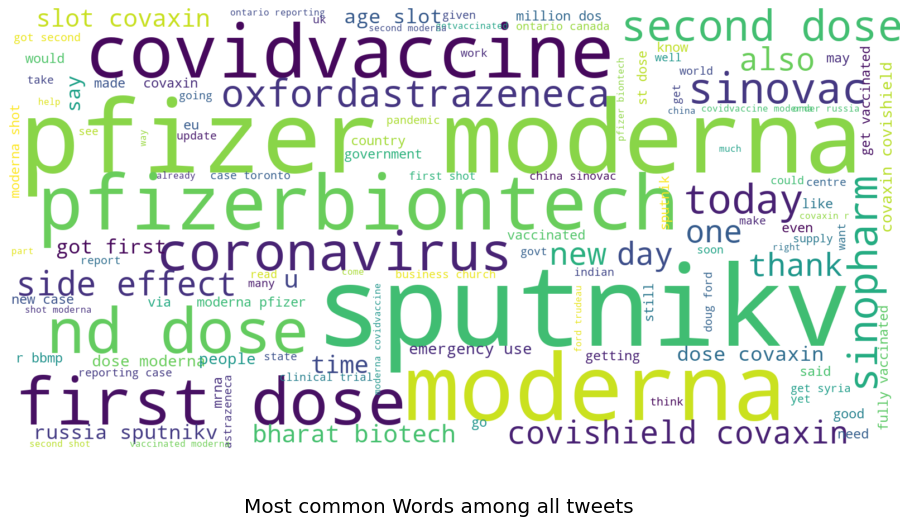

In [44]:
generate_wordcloud(vaccine_tweets["corpus"], "Most common Words among all tweets")

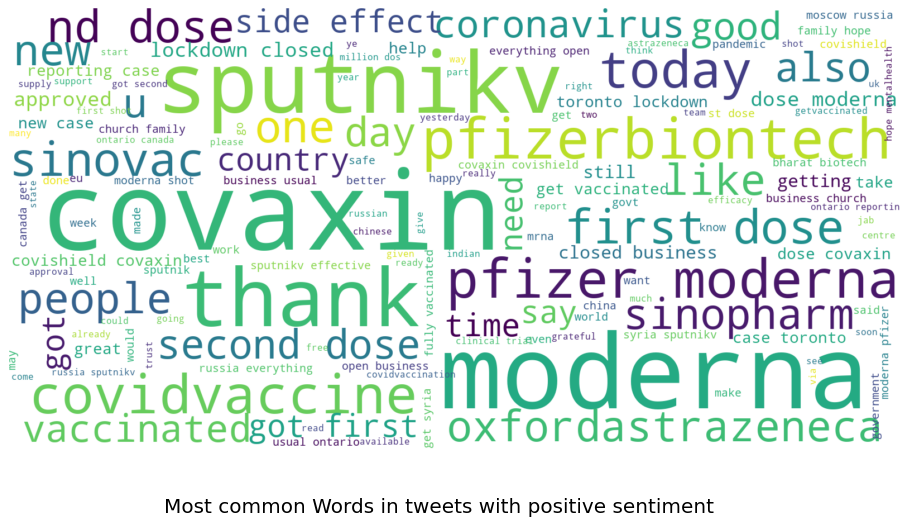

In [45]:
generate_wordcloud(vaccine_tweets["corpus"][vaccine_tweets["sentiment_compound"] >= 0.33], "Most common Words in tweets with positive sentiment")

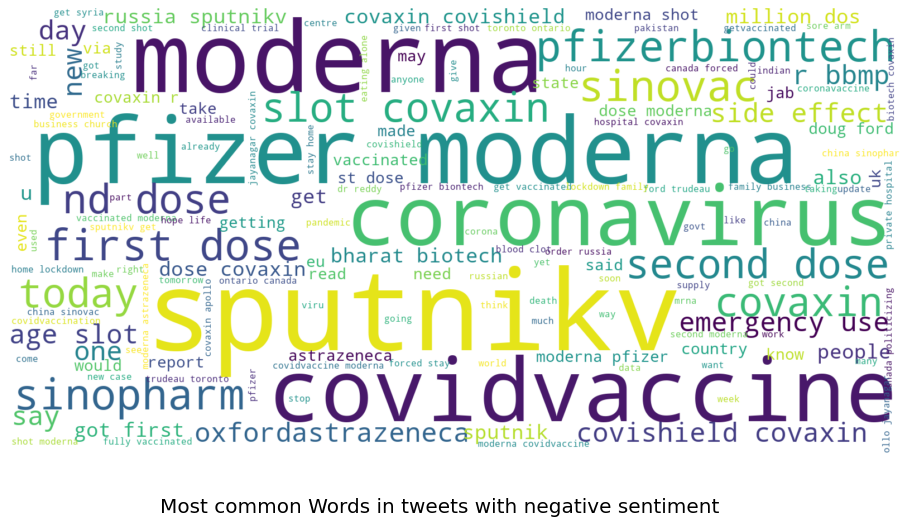

In [46]:
generate_wordcloud(vaccine_tweets["corpus"][vaccine_tweets["sentiment_compound"] <= 0.33], "Most common Words in tweets with negative sentiment")